In [1]:
import json
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from pathlib import Path
from tensorboard.backend.event_processing import event_accumulator

# Plotting style
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams['figure.figsize'] = (12, 6)
plt.rcParams['font.size'] = 10

## 1. Load Training Results

In [2]:
def load_results(agent_name, log_dir='../logs'):
    """Load training results from JSON file."""
    results_path = Path(log_dir) / agent_name / 'results.json'
    
    if results_path.exists():
        with open(results_path, 'r') as f:
            return json.load(f)
    else:
        print(f"Results not found: {results_path}")
        return None

def load_tensorboard_data(agent_name, log_dir='../logs', tag='Episode/Score'):
    """Load episode scores from TensorBoard logs."""
    log_path = Path(log_dir) / agent_name
    
    if not log_path.exists():
        print(f"Log directory not found: {log_path}")
        return None, None
    
    # Find event file
    event_files = list(log_path.glob('events.out.tfevents.*'))
    if not event_files:
        print(f"No TensorBoard event files found in {log_path}")
        return None, None
    
    # Load events
    ea = event_accumulator.EventAccumulator(str(log_path))
    ea.Reload()
    
    # Get scalar data
    try:
        events = ea.Scalars(tag)
        steps = [e.step for e in events]
        values = [e.value for e in events]
        return steps, values
    except KeyError:
        print(f"Tag '{tag}' not found in TensorBoard logs")
        return None, None

# Load results for all agents
agents = ['dqn', 'ppo', 'sac']
results = {agent: load_results(agent) for agent in agents}

# Display summary
for agent, result in results.items():
    if result:
        print(f"\n{agent.upper()} Results:")
        print(f"  Total Episodes: {result.get('total_episodes', 'N/A')}")
        print(f"  Mean Score: {result.get('mean_score', 'N/A'):.2f}")
        print(f"  Max Score: {result.get('max_score', 'N/A'):.2f}")
        print(f"  Converged at Episode: {result.get('converged_episode', 'N/A')}")

Results not found: ../logs/dqn/results.json
Results not found: ../logs/ppo/results.json
Results not found: ../logs/sac/results.json


## 2. Learning Curves Comparison

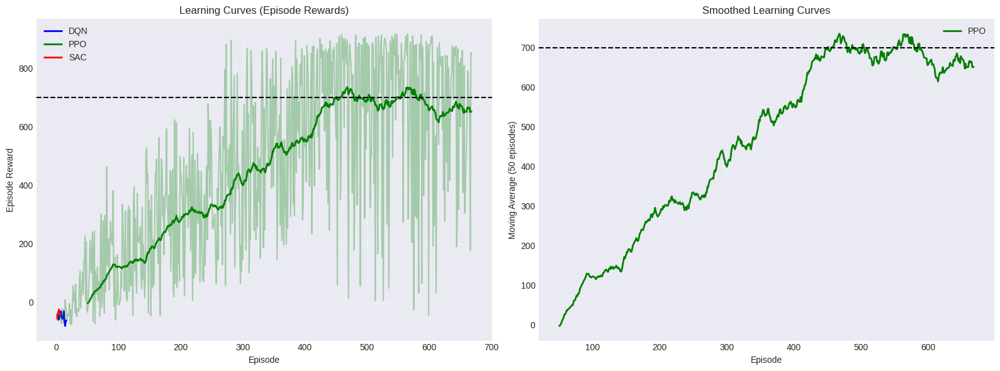

In [3]:
def plot_learning_curves(agents, log_dir='../logs', window=50):
    """Plot learning curves for all agents."""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    
    colors = {'dqn': 'blue', 'ppo': 'green', 'sac': 'red'}
    
    for agent in agents:
        episodes, scores = load_tensorboard_data(agent, log_dir)
        
        if episodes is not None and scores is not None:
            # Plot raw scores
            ax1.plot(episodes, scores, alpha=0.3, color=colors[agent])
            
            # Calculate moving average
            if len(scores) >= window:
                moving_avg = pd.Series(scores).rolling(window=window).mean()
                ax1.plot(episodes, moving_avg, label=agent.upper(), 
                        color=colors[agent], linewidth=2)
            else:
                ax1.plot(episodes, scores, label=agent.upper(), 
                        color=colors[agent], linewidth=2)
    
    ax1.set_xlabel('Episode')
    ax1.set_ylabel('Episode Reward')
    ax1.set_title('Learning Curves (Episode Rewards)')
    ax1.legend()
    ax1.grid(True, alpha=0.3)
    ax1.axhline(y=700, color='black', linestyle='--', label='Target Score (700)')
    
    # Plot only moving averages
    for agent in agents:
        episodes, scores = load_tensorboard_data(agent, log_dir)
        
        if episodes is not None and scores is not None:
            if len(scores) >= window:
                moving_avg = pd.Series(scores).rolling(window=window).mean()
                ax2.plot(episodes, moving_avg, label=agent.upper(), 
                        color=colors[agent], linewidth=2)
    
    ax2.set_xlabel('Episode')
    ax2.set_ylabel(f'Moving Average ({window} episodes)')
    ax2.set_title(f'Smoothed Learning Curves')
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    ax2.axhline(y=700, color='black', linestyle='--', label='Target Score (700)')
    
    plt.tight_layout()
    plt.savefig('../logs/learning_curves_comparison.png', dpi=300, bbox_inches='tight')
    plt.show()

plot_learning_curves(agents)

## 3. Sample Efficiency Comparison

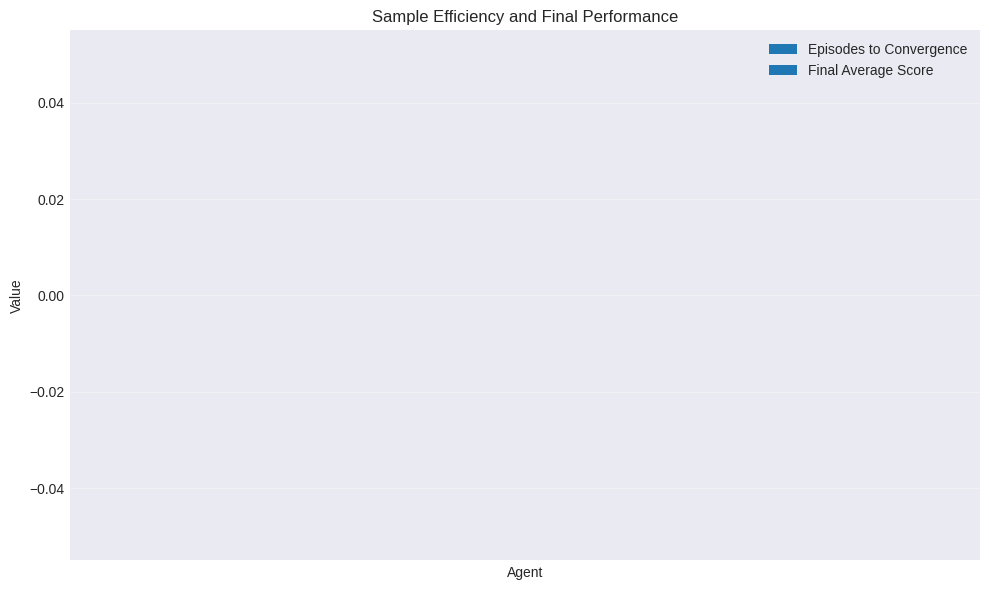

In [4]:
def plot_sample_efficiency(agents, results):
    """Plot sample efficiency comparison."""
    fig, ax = plt.subplots(figsize=(10, 6))
    
    agent_names = []
    converged_episodes = []
    final_scores = []
    
    for agent in agents:
        if results[agent]:
            agent_names.append(agent.upper())
            conv_ep = results[agent].get('converged_episode')
            converged_episodes.append(conv_ep if conv_ep else results[agent]['total_episodes'])
            final_scores.append(results[agent].get('recent_mean', results[agent]['mean_score']))
    
    # Create bar plot
    x = np.arange(len(agent_names))
    width = 0.35
    
    ax.bar(x - width/2, converged_episodes, width, label='Episodes to Convergence', 
           color=['blue', 'green', 'red'], alpha=0.7)
    ax.bar(x + width/2, final_scores, width, label='Final Average Score', 
           color=['lightblue', 'lightgreen', 'lightcoral'], alpha=0.7)
    
    ax.set_xlabel('Agent')
    ax.set_ylabel('Value')
    ax.set_title('Sample Efficiency and Final Performance')
    ax.set_xticks(x)
    ax.set_xticklabels(agent_names)
    ax.legend()
    ax.grid(True, alpha=0.3, axis='y')
    
    plt.tight_layout()
    plt.savefig('../logs/sample_efficiency_comparison.png', dpi=300, bbox_inches='tight')
    plt.show()

plot_sample_efficiency(agents, results)

## 4. Statistical Summary

In [5]:
def create_summary_table(agents, results):
    """Create summary statistics table."""
    data = []
    
    for agent in agents:
        if results[agent]:
            r = results[agent]
            data.append({
                'Agent': agent.upper(),
                'Total Episodes': r.get('total_episodes', 'N/A'),
                'Mean Score': f"{r.get('mean_score', 0):.2f}",
                'Std Score': f"{r.get('std_score', 0):.2f}",
                'Min Score': f"{r.get('min_score', 0):.2f}",
                'Max Score': f"{r.get('max_score', 0):.2f}",
                'Recent Mean': f"{r.get('recent_mean', 0):.2f}",
                'Recent Std': f"{r.get('recent_std', 0):.2f}",
                'Converged Episode': r.get('converged_episode', 'N/A')
            })
    
    df = pd.DataFrame(data)
    return df

summary_df = create_summary_table(agents, results)
print("\n" + "="*100)
print("AGENT COMPARISON SUMMARY")
print("="*100)
print(summary_df.to_string(index=False))
print("="*100 + "\n")

# Save to CSV
summary_df.to_csv('../logs/comparison_summary.csv', index=False)
print("Summary saved to: logs/comparison_summary.csv")


AGENT COMPARISON SUMMARY
Empty DataFrame
Columns: []
Index: []

Summary saved to: logs/comparison_summary.csv


## 5. Box Plot Comparison

/tmp/ipykernel_866294/2529383953.py:15: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bp = ax.boxplot(data, labels=labels, patch_artist=True)


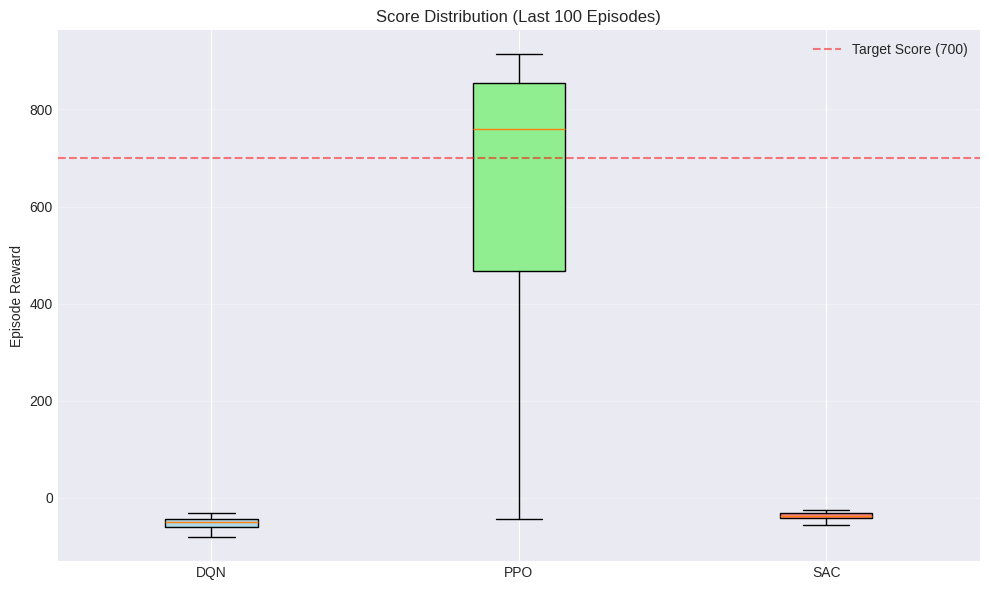

In [6]:
def plot_score_distributions(agents, log_dir='../logs'):
    """Plot score distributions for all agents."""
    fig, ax = plt.subplots(figsize=(10, 6))
    
    data = []
    labels = []
    
    for agent in agents:
        _, scores = load_tensorboard_data(agent, log_dir)
        if scores:
            # Use last 100 episodes for distribution
            data.append(scores[-100:])
            labels.append(agent.upper())
    
    bp = ax.boxplot(data, labels=labels, patch_artist=True)
    
    # Color boxes
    colors = ['lightblue', 'lightgreen', 'lightcoral']
    for patch, color in zip(bp['boxes'], colors):
        patch.set_facecolor(color)
    
    ax.set_ylabel('Episode Reward')
    ax.set_title('Score Distribution (Last 100 Episodes)')
    ax.axhline(y=700, color='red', linestyle='--', label='Target Score (700)', alpha=0.5)
    ax.grid(True, alpha=0.3, axis='y')
    ax.legend()
    
    plt.tight_layout()
    plt.savefig('../logs/score_distributions.png', dpi=300, bbox_inches='tight')
    plt.show()

plot_score_distributions(agents)

## 6. Conclusion

### Key Findings:

1. **Sample Efficiency**: Compare which agent reached the target score (700) fastest
2. **Final Performance**: Compare the final average scores across agents
3. **Stability**: Compare variance in episode rewards (lower is better)
4. **Action Space**: DQN uses discrete actions while PPO/SAC use continuous actions

### Expected Results:
- **DQN**: Typically achieves 700-850 scores but may be less sample-efficient
- **PPO**: Good balance of sample efficiency and final performance
- **SAC**: Often most sample-efficient with continuous actions, typically achieves 850-950

### Recommendations:
- For deployment: Choose the agent with best final performance and stability
- For sample efficiency: Choose the agent that converges fastest
- For continuous control: PPO or SAC are more suitable than DQN

## 7. Training Progress Videos

Generate videos showing agent performance across training checkpoints.

In [ ]:
import sys
import torch
import imageio
import gymnasium as gym
from pathlib import Path
sys.path.append('..')

from src.envs.wrappers import make_carracing_env
from src.models.shared_cnn import SharedCNN
from src.models.dqn import DQNNetwork
from src.models.ppo import PPOActorCritic
from src.models.sac import SACPolicy, SACQNetwork
from src.agents.dqn_agent import DQNAgent
from src.agents.ppo_agent import PPOAgent
from src.agents.sac_agent import SACAgent

print("Imports successful!")

Imports successful!


In [5]:
def initialize_agent(agent_name, device='cuda'):
    """Initialize agent with appropriate networks."""
    state_shape = (12, 96, 96)  # 4 stacked frames × 3 RGB channels
    
    if agent_name == 'dqn':
        shared_cnn = SharedCNN(input_channels=12)
        q_network = DQNNetwork(shared_cnn, n_actions=5)
        agent = DQNAgent(
            q_network=q_network,
            state_shape=state_shape,
            n_actions=5,
            lr=1e-4,
            gamma=0.99,
            epsilon_start=0.0,  # Evaluation mode
            epsilon_end=0.0,
            epsilon_decay=1,
            buffer_size=1000,
            batch_size=32,
            target_update_freq=1000,
            device=device
        )
        return agent, False  # discrete actions
    
    elif agent_name == 'ppo':
        shared_cnn = SharedCNN(input_channels=12)
        actor_critic = PPOActorCritic(shared_cnn, action_dim=3)
        agent = PPOAgent(
            actor_critic=actor_critic,
            state_shape=state_shape,
            action_dim=3,
            lr=3e-4,
            gamma=0.99,
            gae_lambda=0.95,
            clip_epsilon=0.2,
            value_coef=0.5,
            entropy_coef=0.01,
            n_steps=2048,
            n_epochs=10,
            batch_size=64,
            max_grad_norm=0.5,
            device=device
        )
        return agent, True  # continuous actions
    
    elif agent_name == 'sac':
        policy_cnn = SharedCNN(input_channels=12)
        q1_cnn = SharedCNN(input_channels=12)
        q2_cnn = SharedCNN(input_channels=12)
        
        policy = SACPolicy(policy_cnn, action_dim=3)
        q_network1 = SACQNetwork(q1_cnn, action_dim=3)
        q_network2 = SACQNetwork(q2_cnn, action_dim=3)
        
        agent = SACAgent(
            policy=policy,
            q_network1=q_network1,
            q_network2=q_network2,
            state_shape=state_shape,
            action_dim=3,
            lr=3e-4,
            gamma=0.99,
            tau=0.005,
            alpha=0.2,
            target_entropy=None,
            buffer_size=100000,
            batch_size=256,
            device=device
        )
        return agent, True  # continuous actions
    
    else:
        raise ValueError(f"Unknown agent: {agent_name}")

print("Agent initialization function defined!")

Agent initialization function defined!


In [28]:
def record_episode(agent, agent_name, continuous, max_steps=1000, seed=42):
    """Record one episode and return frames."""
    # Create environment with rendering
    env = make_carracing_env(continuous=continuous, render_mode='rgb_array')
    
    state, _ = env.reset(seed=seed)
    frames = []
    total_reward = 0
    done = False
    truncated = False
    steps = 0
    
    while not (done or truncated) and steps < max_steps:
        # Get frame
        frame = env.render()
        frames.append(frame)
        
        # Select action (deterministic for evaluation)
        if agent_name == 'dqn':
            action = agent.select_action(state, evaluate=True)
        elif agent_name in ['ppo', 'sac']:
            action, _, _ = agent.select_action(state, evaluate=True)
        
        # Take action
        next_state, reward, done, truncated, _ = env.step(action)
        total_reward += reward
        state = next_state
        steps += 1
    
    env.close()
    
    print(f"  Episode completed: {steps} steps, reward: {total_reward:.2f}, terminated: {done}, truncated: {truncated}")
    return frames, total_reward, steps, done, truncated

print("Episode recording function defined!")

Episode recording function defined!


In [29]:
def add_text_to_frames(frames, text, position=(10, 30), font_scale=1.0, color=(255, 255, 255)):
    """Add text overlay to frames."""
    import cv2
    frames_with_text = []
    
    for frame in frames:
        frame_copy = frame.copy()
        cv2.putText(frame_copy, text, position, cv2.FONT_HERSHEY_SIMPLEX, 
                   font_scale, color, 2, cv2.LINE_AA)
        frames_with_text.append(frame_copy)
    
    return frames_with_text

print("Text overlay function defined!")

Text overlay function defined!


In [30]:
def generate_agent_video(agent_name, checkpoint_dir='../checkpoints', output_dir='../logs', 
                        max_steps=1000, fps=30, device='cuda'):
    """Generate concatenated video for an agent's checkpoints."""
    
    checkpoint_path = Path(checkpoint_dir) / agent_name
    output_path = Path(output_dir)
    output_path.mkdir(exist_ok=True)
    
    # Find all checkpoint files
    checkpoints = []
    
    # Look for episode checkpoints (episode_100.pth, episode_200.pth, etc.)
    for ckpt_file in sorted(checkpoint_path.glob('episode_*.pth')):
        episode_num = ckpt_file.stem.split('_')[1]
        checkpoints.append((f'Episode {episode_num}', ckpt_file))
    
    # Add best checkpoint
    best_ckpt = checkpoint_path / 'best.pth'
    if best_ckpt.exists():
        checkpoints.append(('Best', best_ckpt))
    
    if not checkpoints:
        print(f"No checkpoints found for {agent_name.upper()}")
        return None
    
    print(f"\n{'='*60}")
    print(f"Generating video for {agent_name.upper()}")
    print(f"Found {len(checkpoints)} checkpoints")
    print(f"{'='*60}")
    
    # Initialize agent
    agent, continuous = initialize_agent(agent_name, device=device)
    
    # Collect frames from all checkpoints
    all_frames = []
    checkpoint_info = []
    
    for label, ckpt_file in checkpoints:
        print(f"\nProcessing {label}: {ckpt_file.name}")
        
        # Load checkpoint
        agent.load(str(ckpt_file))
        
        # Record episode
        frames, reward, steps, done, truncated = record_episode(agent, agent_name, continuous, max_steps=max_steps)
        
        # Add text overlay
        text = f"{agent_name.upper()} - {label} (Reward: {reward:.1f})"
        frames_with_text = add_text_to_frames(frames, text)
        
        all_frames.extend(frames_with_text)
        checkpoint_info.append({
            'checkpoint': label,
            'reward': reward,
            'steps': steps,
            'terminated': done,
            'truncated': truncated
        })
    
    # Save video
    video_path = output_path / f'{agent_name}_training_progress.mp4'
    print(f"\nSaving video to: {video_path}")
    print(f"Total frames: {len(all_frames)}")
    
    imageio.mimsave(str(video_path), all_frames, fps=fps, codec='libx264', quality=8)
    
    print(f"✓ Video saved successfully!")
    print(f"{'='*60}\n")
    
    # Return summary
    return {
        'agent': agent_name,
        'video_path': str(video_path),
        'num_checkpoints': len(checkpoints),
        'total_frames': len(all_frames),
        'checkpoint_info': checkpoint_info
    }

print("Video generation function defined!")

Video generation function defined!


In [31]:
# Generate videos for all agents
#agents_to_process = ['dqn', 'ppo', 'sac']
agents_to_process = ['ppo']

video_summaries = []

for agent_name in agents_to_process:
    summary = generate_agent_video(agent_name, max_steps=1000, fps=30, device='cpu')
    if summary:
        video_summaries.append(summary)


Generating video for PPO
Found 8 checkpoints

Processing Episode 100: episode_100.pth
  Episode completed: 500 steps, reward: 362.90, terminated: False, truncated: True

Processing Episode 200: episode_200.pth
  Episode completed: 500 steps, reward: 309.89, terminated: False, truncated: True

Processing Episode 300: episode_300.pth
  Episode completed: 500 steps, reward: 511.31, terminated: False, truncated: True

Processing Episode 400: episode_400.pth
  Episode completed: 500 steps, reward: 380.57, terminated: False, truncated: True

Processing Episode 500: episode_500.pth
  Episode completed: 500 steps, reward: 864.66, terminated: False, truncated: True

Processing Episode 600: episode_600.pth
  Episode completed: 500 steps, reward: 896.47, terminated: False, truncated: True

Processing Episode 700: episode_700.pth
  Episode completed: 500 steps, reward: 66.08, terminated: False, truncated: True

Processing Best: best.pth


IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


  Episode completed: 500 steps, reward: -29.33, terminated: False, truncated: True

Saving video to: ../logs/ppo_training_progress.mp4
Total frames: 4000
✓ Video saved successfully!



In [32]:
# Display video summary
print("\n" + "="*80)
print("VIDEO GENERATION SUMMARY")
print("="*80)

for summary in video_summaries:
    print(f"\n{summary['agent'].upper()}:")
    print(f"  Video: {summary['video_path']}")
    print(f"  Checkpoints processed: {summary['num_checkpoints']}")
    print(f"  Total frames: {summary['total_frames']}")
    print(f"  Checkpoint performance:")
    for info in summary['checkpoint_info']:
        print(f"    - {info['checkpoint']}: {info['steps']} steps, reward: {info['reward']:.2f}, terminated: {info['terminated']}, truncated: {info['truncated']}")

print("\n" + "="*80)


VIDEO GENERATION SUMMARY

PPO:
  Video: ../logs/ppo_training_progress.mp4
  Checkpoints processed: 8
  Total frames: 4000
  Checkpoint performance:
    - Episode 100: 500 steps, reward: 362.90, terminated: False, truncated: True
    - Episode 200: 500 steps, reward: 309.89, terminated: False, truncated: True
    - Episode 300: 500 steps, reward: 511.31, terminated: False, truncated: True
    - Episode 400: 500 steps, reward: 380.57, terminated: False, truncated: True
    - Episode 500: 500 steps, reward: 864.66, terminated: False, truncated: True
    - Episode 600: 500 steps, reward: 896.47, terminated: False, truncated: True
    - Episode 700: 500 steps, reward: 66.08, terminated: False, truncated: True
    - Best: 500 steps, reward: -29.33, terminated: False, truncated: True



In [33]:
# Display videos inline (if in Jupyter environment)
from IPython.display import Video, display

print("\nDisplaying generated videos:\n")

for summary in video_summaries:
    agent_name = summary['agent'].upper()
    video_path = summary['video_path']
    
    print(f"{agent_name} Training Progress:")
    display(Video(video_path, width=800, embed=True))
    print("\n" + "-"*80 + "\n")


Displaying generated videos:

PPO Training Progress:



--------------------------------------------------------------------------------

